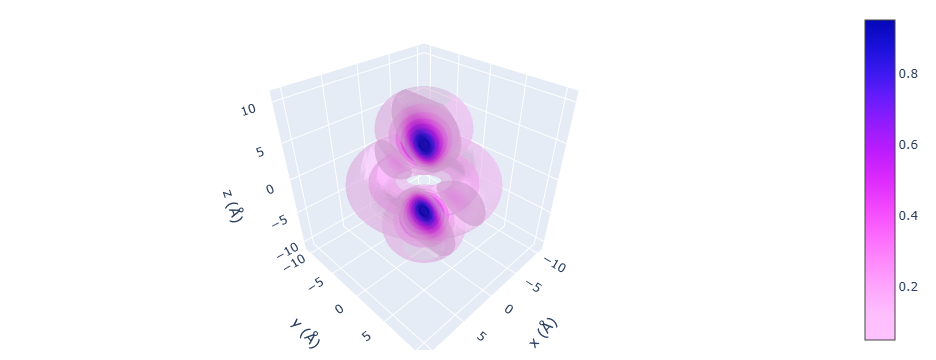

In [11]:
import numpy as np
import plotly.graph_objects as go
from scipy import constants

a0      = constants.physical_constants['Bohr radius'][0]
Angstrom = constants.angstrom

def r_phi_theta(x, y, z):
    r     = np.sqrt(x**2 + y**2 + z**2)
    phi   = np.arctan2(y, x) + np.pi
    theta = np.arccos(z / r)
    return r, phi, theta

X, Y, Z = np.mgrid[
    -20*a0:20*a0:48j,
    -20*a0:20*a0:48j,
    -20*a0:20*a0:48j
]
r_grid, phi_grid, theta_grid = r_phi_theta(X, Y, Z)

def probfunc(r, ψ):
    p = r**2 * np.conj(ψ) * ψ
    return p.real / np.max(p.real)

n3l2m0 = lambda r, θ: (
    (r**2 / a0**2)
    * np.exp(-r/(3*a0))
    * (3*np.cos(θ)**2 - 1)
    / (81 * np.sqrt(6*np.pi) * a0**1.5)
)

prob_n3l2m0 = probfunc(r_grid, n3l2m0(r_grid, theta_grid))

fig = go.Figure(data=go.Isosurface(
    x=X.flatten()/Angstrom,
    y=Y.flatten()/Angstrom,
    z=Z.flatten()/Angstrom,
    value=prob_n3l2m0.flatten(),
    isomin=0.05, isomax=0.95,
    opacity=0.4, colorscale='Plotly3_r',
    surface_count=8, colorbar_nticks=8,
    slices_x=dict(show=True, locations=[0]),
    caps=dict(x_show=False, y_show=False, z_show=False)
))
fig.update_layout(
    scene=dict(
        xaxis_title='x (Å)',
        yaxis_title='y (Å)',
        zaxis_title='z (Å)'
    ), width=700, margin=dict(r=10, b=10, l=10, t=10)
)
fig.show()
